<a href="https://colab.research.google.com/github/CRekkaran/Instant-Background/blob/master/Part_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab
# install detectron2:
!pip install detectron2==0.1.2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/index.html

# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
Requirement already up-to-date: torch==1.5 in /usr/local/lib/python3.6/dist-packages (1.5.0+cu101)
Requirement already up-to-date: torchvision==0.6 in /usr/local/lib/python3.6/dist-packages (0.6.0+cu101)
     |████████████████████████████████| 276kB 2.8MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp36-cp36m-linux_x86_64.whl size=44074 sha256=64b836c865307358e99966c967c61c230d5a12cb6fb686f0e347f5ffce7464f1
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-f8h6cy47
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-f8h6cy47
  Created wheel for pycocotools: filename=pycocotools-2.0-cp36-cp36m-lin

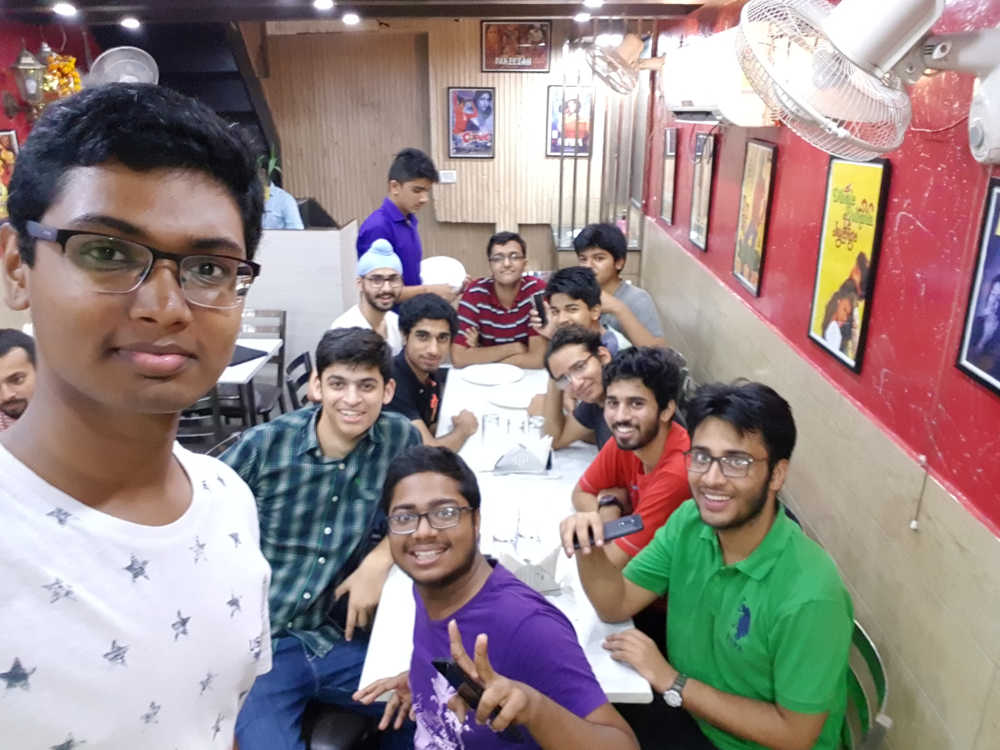

In [2]:
path = '/content/drive/My Drive/pics/Aditya birthday (Sep 2017)/'
im = cv2.imread(path + '20170928_214942.jpg')
cv2_imshow(im)

In [4]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)

model_final_f10217.pkl: 178MB [00:13, 13.5MB/s]                           


In [5]:
!nvidia-smi

Wed May 13 12:09:22 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.82       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   48C    P0    35W / 250W |   3751MiB / 16280MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [7]:
outputs["instances"].pred_classes
outputs["instances"].pred_boxes

Boxes(tensor([[1854.3964, 1238.0569, 2798.7705, 2444.9153],
        [ 707.5065, 1057.4440, 1375.2391, 2393.5000],
        [   0.0000,  251.6372,  944.2808, 2429.9934],
        [1107.0515, 1447.2102, 2070.5024, 2445.5266],
        [1868.8590,  721.4469, 2159.9946, 1136.9310],
        [   0.0000, 1073.5565,  128.3231, 1399.3024],
        [1486.7917,  735.7043, 1794.3811, 1212.7482],
        [1825.5806, 1152.7256, 2279.8691, 2144.7898],
        [ 841.5164,  506.0156,  998.0212,  751.8104],
        [1163.1105,  481.4292, 1463.8739,  972.7686],
        [1255.2042,  963.6381, 1540.8995, 1445.6183],
        [1404.2063, 2148.0239, 1585.5094, 2305.2773],
        [1068.8229,  799.4065, 1321.3137, 1194.7645],
        [ 927.4644, 1148.5365, 1019.2096, 1344.1866],
        [2168.4248, 2251.6550, 2224.0994, 2308.1240],
        [1751.4712, 1062.4250, 1994.3795, 1479.0353],
        [2630.6970,  513.1907, 2896.8665, 1189.7998],
        [ 591.9462, 1083.8473,  921.9221, 1434.7170],
        [1738.8217,  9

In [12]:
im[:,:, ::-1]

array([[[ 85,  67,  91],
        [ 84,  66,  90],
        [ 85,  65,  90],
        ...,
        [193, 136, 155],
        [193, 136, 155],
        [194, 137, 156]],

       [[ 82,  64,  88],
        [ 80,  62,  86],
        [ 81,  61,  86],
        ...,
        [192, 135, 154],
        [193, 136, 155],
        [194, 137, 156]],

       [[ 78,  60,  84],
        [ 78,  60,  84],
        [ 80,  62,  86],
        ...,
        [192, 133, 153],
        [191, 132, 152],
        [193, 134, 154]],

       ...,

       [[209, 210, 215],
        [210, 211, 216],
        [210, 211, 216],
        ...,
        [174, 167, 139],
        [175, 168, 140],
        [174, 167, 139]],

       [[210, 211, 216],
        [211, 212, 217],
        [210, 211, 216],
        ...,
        [175, 168, 140],
        [174, 167, 139],
        [173, 166, 138]],

       [[211, 212, 217],
        [211, 212, 217],
        [210, 211, 216],
        ...,
        [173, 166, 138],
        [171, 164, 136],
        [172, 165, 137]]

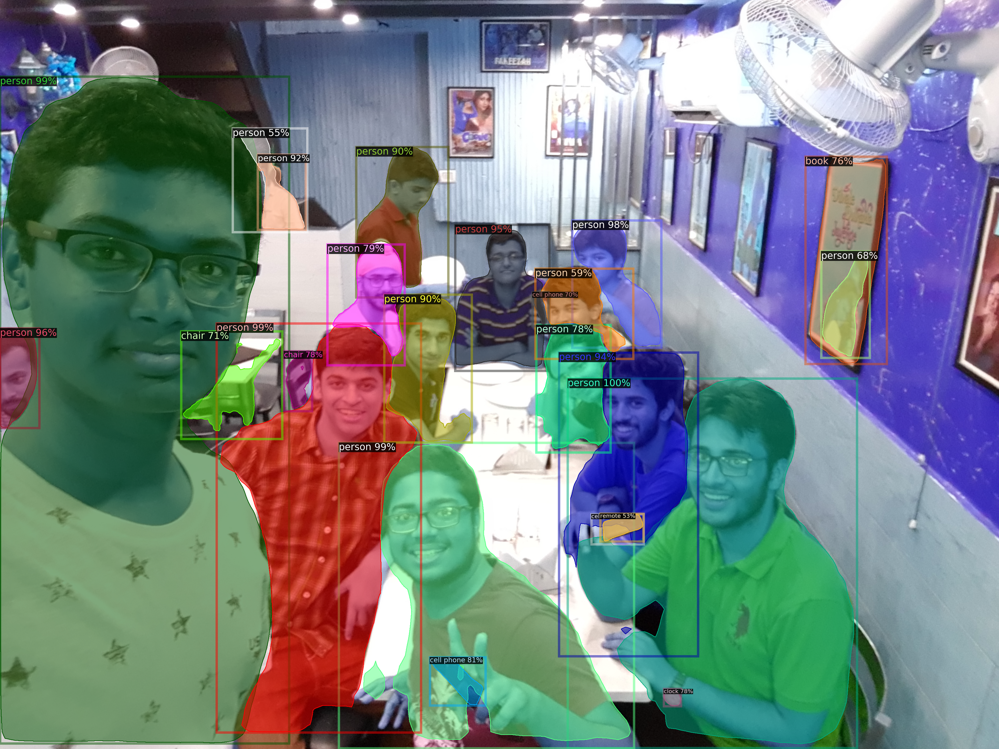

In [11]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])